# Application: Skin Lesion Classification


### Purpose
Solve [_Task 3: Disease Classification_][task3] from the [ISIC 2018 Challenge _Skin Lesion Analysis Towards Melanoma Detection_][ISIC2018Challenge].

The 7 possible disease categories are:
  * Melanoma
  * Melanocytic nevus
  * Basal cell carcinoma
  * Actinic keratosis / Bowen’s disease (intraepithelial carcinoma)
  * Benign keratosis (solar lentigo / seborrheic keratosis / lichen planus-like keratosis)
  * Dermatofibroma
  * Vascular lesion

### Credits
This project uses the ISIC 2018 datasets:

[1] Noel Codella, Veronica Rotemberg, Philipp Tschandl, M. Emre Celebi, Stephen Dusza, David Gutman, Brian Helba, Aadi Kalloo, Konstantinos Liopyris, Michael Marchetti, Harald Kittler, Allan Halpern: “Skin Lesion Analysis Toward Melanoma Detection 2018: A Challenge Hosted by the International Skin Imaging Collaboration (ISIC)”, 2018; https://arxiv.org/abs/1902.03368

[2] Tschandl, P., Rosendahl, C. & Kittler, H. The HAM10000 dataset, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. Sci. Data 5, 180161 doi:10.1038/sdata.2018.161 (2018).

[task3]: https://challenge2018.isic-archive.com/task3/
[ISIC2018Challenge]: https://challenge2018.isic-archive.com/

# Group 8
<ul>
<li>Divij Pawar 
<li>Aaron Mailhot
<li>Sohail Qadir
<li>Modib Qadir
</ul>

Skin Cancer Classification 
=====================
In this tutorial we aim to provide a simple step-by-step guide to anyone who wants to work on the problem of skin lesion classification regardless of their level or expertise; from medical doctors, to master students and more experienced researchers.

## Using this guide you will learn:

- How to load the data, visualise it and uncover more about the class distribution and meta-data.
- How to utilise architectures with varying complexity from a few convolutional layers to hundreds of them.
- How to train a model with appropriate optimisers and loss functions.
- How to rigorously test your trained model, providing not only metrics such as accuracy but also visualisations like confusion matrix and Grad — Cam.
- How to analyse and understand your results.

To conclude with, we will provide a few more tips that are usually utilised by the participants of the ISIC Challenges, that will help you increase your model’s performance even more so that you can beat our performance and explore more advanced training schemes.

# Dependencies
- jupyter
- matplotlib
- numpy
- scikit-learn
- torch
- torchvision
- pandas
- imageio
- seaborn
- glob3
- scipy

# Short report 
The changes I made to the code were mostly due to syntax from older versions of libraries.
This included:
<ul>
    <li> AttributeError: '_MultiProcessingDataLoaderIter' object has no attribute 'next' . This was due to how next was used previously and is now used as a function next </li>
    <li> Wrong datatype used. numpy.float() was used instead I replaced it with float(). This is also an old syntax error. This could also be replaced with numpy.float64() </li>
    <li> The code also has errors that are not just bugs. The class accuracy is skewed towards a few classes. 4 classes have 0% accuracy, while 3 have more than 47%. This is one of the problems I couldnt understand and will research some more about. </li>
</ul>

All in all this assignment helped me understand the layers of Lenet architecture and the pytorch framework helped be build the model piece by piece. The Adam optimizer was also something I got to work with for the first time.

In [ ]:
# !pip install imageio
# !pip install scikit-image

# # ! NEW TO ADD
# !pip install torchvision 
# !pip install pandas
# !pip install scikit-learn
# !pip install seaborn


In [1]:
import torch
from torch import nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import numpy as np
import os
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')


What about data?
----------------

The HAM10000 ("Human Against Machine with 10000 training images") dataset which contains 10,015 dermatoscopic images was made publically available by the Harvard database on June 2018 in the hopes to provide training data for automating the process of skin cancer lesion classifications. The motivation behind this act was to provide the public with an abundance and variability of data source for machine learning training purposes such that the results may be compared with that of human experts. If successful, the appplications would bring cost and time saving regimes to hospitals and medical professions alike.

Apart from the 10,015 images, a metadata file with demographic information of each lesion is provided as well. More than 50% of lesions are confirmed through histopathology (histo), the ground truth for the rest of the cases is either follow-up examination (follow_up), expert consensus (consensus), or confirmation by in-vivo confocal microscopy (confocal)

You can download the dataset here: https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/DBW86T

The 7 classes of skin cancer lesions included in this dataset are:

1. Melanocytic nevi
2. Melanoma
3. Benign keratosis-like lesions
4. Basal cell carcinoma
5. Actinic keratoses
6. Vascular lesions
7. Dermatofibroma


#### Let's analyze the metadata of the dataset

In [2]:
# importing metadata and checking for its shape
metadata = pd.read_csv('/usr/cs/grad/masters/2025/dpawar/chm/HAM10000_metadata')
metadata.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,vidir_modern
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,vidir_modern
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,vidir_modern
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,vidir_modern
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,vidir_modern


Now, let’s see how the data is distributed based on each feature.

In [3]:
# Getting a sense of what the distribution of each column looks like
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10015 entries, 0 to 10014
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   lesion_id     10015 non-null  object 
 1   image_id      10015 non-null  object 
 2   dx            10015 non-null  object 
 3   dx_type       10015 non-null  object 
 4   age           9958 non-null   float64
 5   sex           10015 non-null  object 
 6   localization  10015 non-null  object 
 7   dataset       10015 non-null  object 
dtypes: float64(1), object(7)
memory usage: 626.1+ KB


There are similar lesions across same images, upto 3 images

Text(0.5, 1.0, 'Distribution of Unique lesions, Column lesion_id')

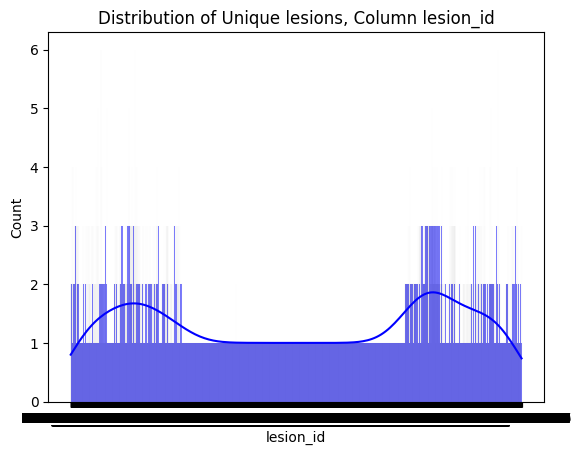

In [4]:
sns.histplot(metadata['lesion_id'], kde=True, color='blue')
plt.title('Distribution of Unique lesions, Column lesion_id')

There are multiple occurances of the same type of diagnosis, Nevus having the highest

Text(0.5, 1.0, 'Distribution of Diagnostics, Column dx')

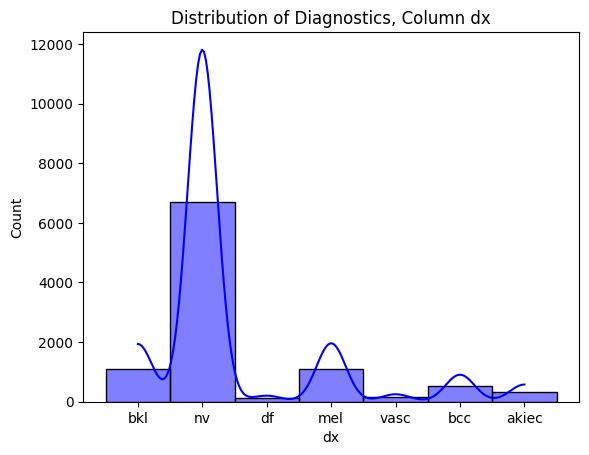

In [5]:
sns.histplot(metadata['dx'], kde=True, color='blue')
plt.title('Distribution of Diagnostics, Column dx')

The data isnt balanced and doesnt contain a lot of confocal-type of diagnosis. It has a lot of histo-type diagnosis

Text(0.5, 1.0, 'Distribution of Diagnostics-type, Column dx_type')

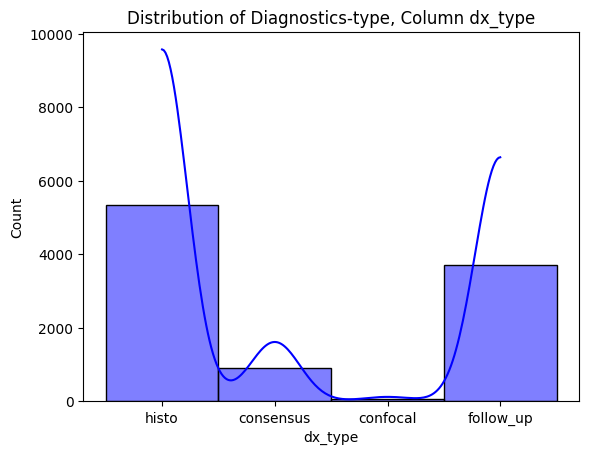

In [6]:
sns.histplot(metadata['dx_type'], kde=True, color='blue')
plt.title('Distribution of Diagnostics-type, Column dx_type')

The data is of patients who are mostly middle aged

Text(0.5, 1.0, 'Distribution of Age, Column age')

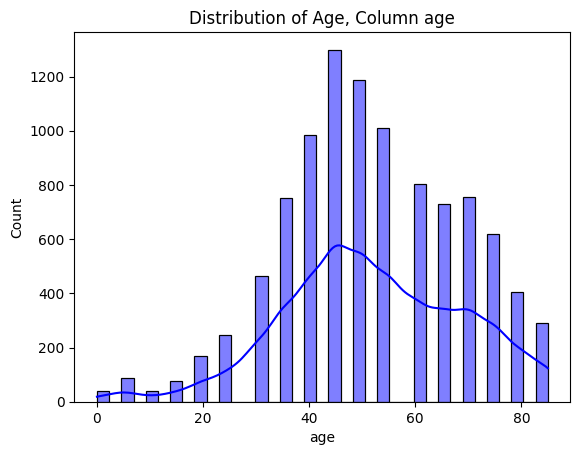

In [7]:
sns.histplot(metadata['age'], kde=True, color='blue')
plt.title('Distribution of Age, Column age')

The sex-ratio of the datasets is balanced, with some unknown values

Text(0.5, 1.0, 'Distribution of Sex, Column sex')

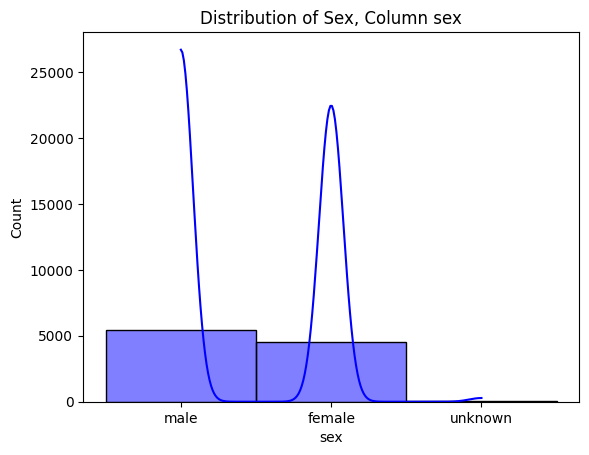

In [8]:
sns.histplot(metadata['sex'], kde=True, color='blue')
plt.title('Distribution of Sex, Column sex')

The image taken are of localizations which are mostly on the back and the lower extremity of the patients

Text(0.5, 1.0, 'Distribution of Localization, Column localization')

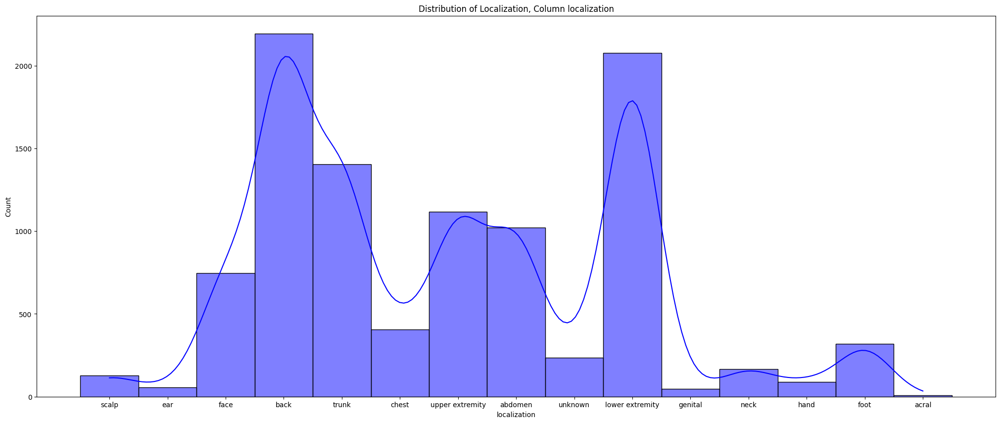

In [9]:
plt.figure(figsize=(25, 10))
sns.histplot(metadata['localization'], kde=True, color='blue')
plt.title('Distribution of Localization, Column localization')

There are 4 datasets used to create this dataset.

Text(0.5, 1.0, 'Distribution of datasets used, Column dataset')

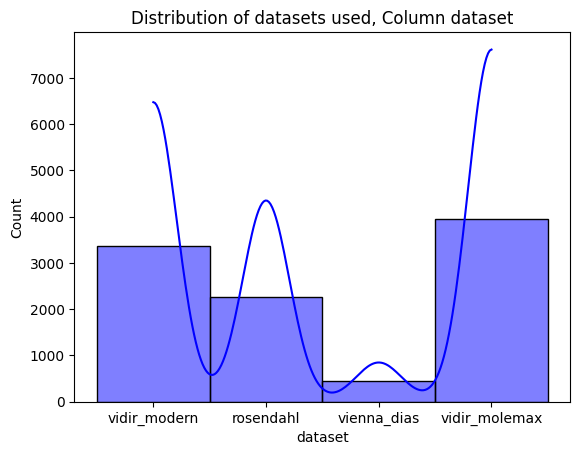

In [10]:
sns.histplot(metadata['dataset'], kde=True, color='blue')
plt.title('Distribution of datasets used, Column dataset')

#### Data Loading and Pre-processing
(This was in the wrong ordering for the github code)
Before we load the data we need to alter the dataset structure.
When you download the dataset, all the images are together in a folder. To use Pytorch dataloader we need to seggregrate the images into folders of their respetive labels. You can use the following script to automate the process.

In [11]:
import os
import shutil

label_list = list(metadata['dx'].unique())
cwd = os.getcwd()
if not (os.path.exists(f'{cwd}/lesion-folder') and os.path.isdir(f'{cwd}/lesion-folder')):
    os.mkdir(f'{cwd}/lesion-folder')
    for label in label_list:
        os.mkdir(f'{cwd}/lesion-folder/{label}')

    folder = os.listdir()
    metadata
    for index, row in metadata.iterrows():
        shutil.copy(f"{cwd}/HAM10000_images/{row['image_id']}.jpg", f"{cwd}/lesion-folder/{row['dx']}") 
    
    print("Folder structure created")
else:
    print("Folder structure already exists")

Folder structure already exists


#### Overcome Class Imbalance: Median Frequency Balancing
As we saw above that there is class imbalance in our dataset. To solve that we use this method.


It is very essential to address the issue of class imbalance we detected from the metadata analysis. If we don’t explicitly take measures against it, the results will be suboptimal as the network will be biased towards the over-represented classes and won’t have the chance to learn the distributions of the under-represented ones. 

So, as we will explain in the section about loss functions, we assign weights to each class within our loss function to allow for balanced training among classes.

To calculate the class weights, we employ a technique called Median Frequency Balancing. 

##### Reference paper: 
D. Eigen, R. Fergus, Predicting depth, surface normals and semantic labels with a common multi-scale convolutional architecture, Proceedings of the IEEE International Conference on Computer Vision, pages 2650–2658, 2015

In [12]:
class_freq={} # dictionary containing all classes
lens=np.zeros(len(metadata['dx'].unique())) #np array with all class lengths
for i,dx in enumerate(metadata['dx'].unique()):
    lens[i]= metadata['dx'].value_counts()[dx]
    class_freq[dx] = lens[i]
class_median = np.median(lens)
print("Median Frequency")
for dx in metadata['dx'].unique():
    class_freq[dx] = class_median / class_freq[dx]
    # print(f"{dx}\t{class_freq[dx]}")
print(class_freq)

Median Frequency
{'bkl': 0.467697907188353, 'nv': 0.07665920954511558, 'df': 4.469565217391304, 'mel': 0.4618149146451033, 'vasc': 3.619718309859155, 'bcc': 1.0, 'akiec': 1.5718654434250765}


#### Data Visualization

Let’s display 5 images per class to visually understand the task at hand and see if there are any similarities between classes that could make the task more challenging.

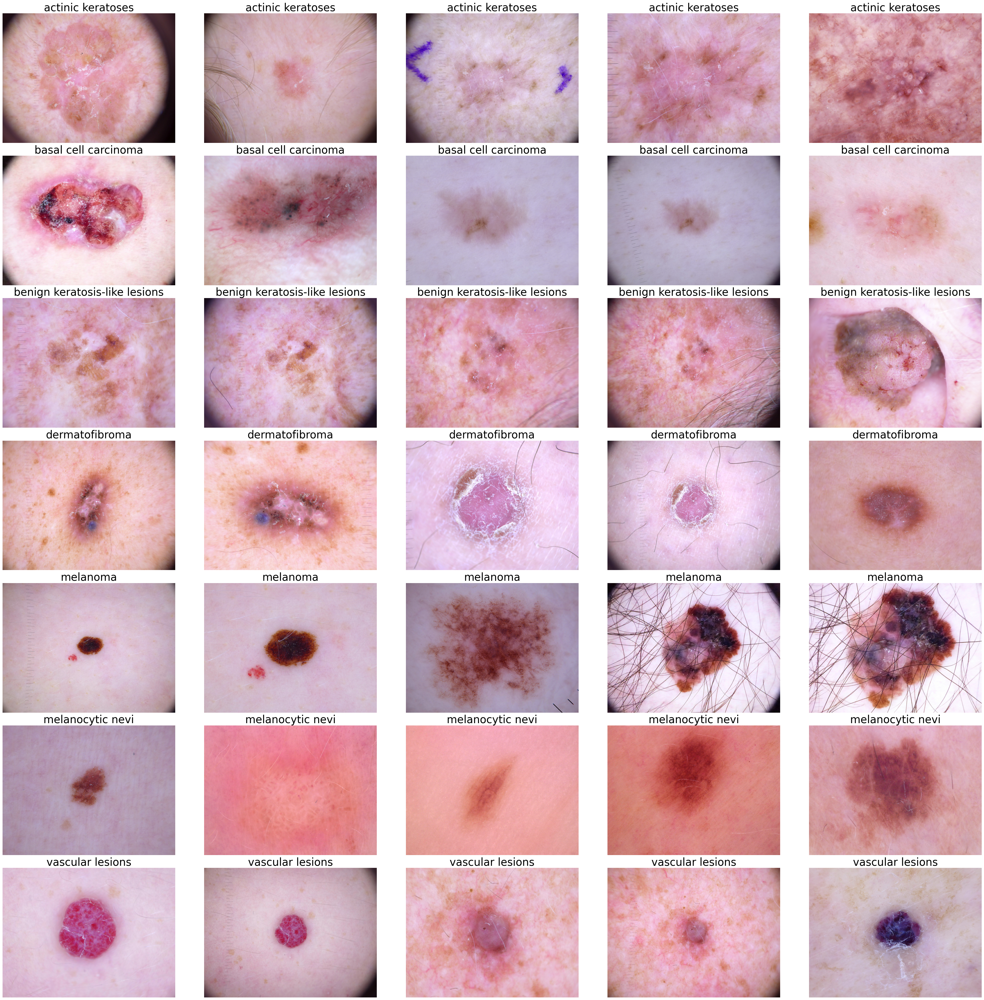

In [13]:
#Visualizing the images
cwd = os.getcwd()
label = [ 'akiec', 'bcc','bkl','df','mel', 'nv',  'vasc']
label_images = []
classes = [ 'actinic keratoses', 'basal cell carcinoma', 'benign keratosis-like lesions', 
          'dermatofibroma','melanoma', 'melanocytic nevi', 'vascular lesions']

for dx in label:
    rows = metadata[metadata['dx'] == dx]
    samples = rows['image_id'][:5]
    for sample in samples:
        sample = f"{dx}/{sample}.jpg"
        label_images.append(sample)
fig, axs = plt.subplots(7, 5, figsize=(50, 50))
fig.subplots_adjust(hspace=0.1, wspace=0.1)

for i, ax in enumerate(axs.flat):
    if i < len(label_images):
        # Read and plot the image
        img = plt.imread(f"{cwd}/lesion-folder/{label_images[i]}")
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(f'{classes[int(i/5)]}', fontsize=30)

In [14]:
# normalization values for pretrained resnet on Imagenet
norm_mean = (0.4914, 0.4822, 0.4465)
norm_std = (0.2023, 0.1994, 0.2010)

batch_size = 50
validation_batch_size = 10
test_batch_size = 10

# We compute the weights of individual classes and convert them to tensors
class_weights = list(class_freq.values())
class_weights = torch.FloatTensor(class_weights)

transform_train = transforms.Compose([
                    transforms.Resize((224,224)),
                    transforms.RandomHorizontalFlip(),
                    transforms.RandomRotation(degrees=60),
                    transforms.ToTensor(),
                    transforms.Normalize(norm_mean, norm_std),
                    ])

transform_test = transforms.Compose([
                    transforms.Resize((224,224)),
                    transforms.ToTensor(),
                    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
                    ])


In [15]:
import torch as th
import math

data_dir = "/usr/cs/grad/masters/2025/dpawar/chm/lesion-folder"
test_size = 0.2
val_size = 0.2
class Sampler(object):
    """Base class for all Samplers.
    """

    def __init__(self, data_source):
        pass

    def __iter__(self):
        raise NotImplementedError

    def __len__(self):
        raise NotImplementedError
        
class StratifiedSampler(Sampler):
    """Stratified Sampling
    Provides equal representation of target classes
    """
    def __init__(self, class_vector):
        """
        Arguments
        ---------
        class_vector : torch tensor
            a vector of class labels
        batch_size : integer
            batch_size
        """
        self.n_splits = 1
        self.class_vector = class_vector
        self.test_size = test_size

    def gen_sample_array(self):
        try:
            from sklearn.model_selection import StratifiedShuffleSplit
        except:
            print('Need scikit-learn for this functionality')
        import numpy as np
        
        s = StratifiedShuffleSplit(n_splits=self.n_splits, test_size=self.test_size)
        X = th.randn(self.class_vector.size(0),2).numpy()
        y = self.class_vector.numpy()
        s.get_n_splits(X, y)

        train_index, test_index= next(s.split(X, y))
        return train_index, test_index

    def __iter__(self):
        return iter(self.gen_sample_array())

    def __len__(self):
        return len(self.class_vector)
    

dataset = torchvision.datasets.ImageFolder(root= data_dir)
data_label = [s[1] for s in dataset.samples]

ss = StratifiedSampler(torch.FloatTensor(data_label))
pre_train_indices, test_indices = ss.gen_sample_array()
# The "pre" is necessary to use array to identify train/ val indices with indices generated by second sampler

train_label = np.delete(data_label, test_indices, None)
ss = StratifiedSampler(torch.FloatTensor(train_label))
train_indices, val_indices = ss.gen_sample_array()
indices = {'train': pre_train_indices[train_indices],  # Indices of second sampler are used on pre_train_indices
           'val': pre_train_indices[val_indices],  # Indices of second sampler are used on pre_train_indices
           'test': test_indices
           }

train_indices = indices['train']
val_indices = indices['val']
test_indices = indices['test']
print("Train Data Size:", len(train_indices))
print("Test Data Size:", len(test_indices))
print("Validation Data Size:", len(val_indices))


Train Data Size: 6409
Test Data Size: 2003
Validation Data Size: 1603


In [16]:
SubsetRandomSampler = torch.utils.data.sampler.SubsetRandomSampler

dataset = torchvision.datasets.ImageFolder(root= data_dir, transform=transform_train)

train_samples = SubsetRandomSampler(train_indices)
val_samples = SubsetRandomSampler(val_indices)
test_samples = SubsetRandomSampler(test_indices)

train_data_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False,num_workers=1, sampler= train_samples)
validation_data_loader = torch.utils.data.DataLoader(dataset, batch_size=validation_batch_size, shuffle=False, sampler=val_samples)

dataset = torchvision.datasets.ImageFolder(root= data_dir, transform=transform_test)
test_data_loader = torch.utils.data.DataLoader(dataset, batch_size=test_batch_size, shuffle=False, sampler=test_samples)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanoma,  benign keratosis-like lesions,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  vascular lesions,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  basal cell carcinoma,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  dermatofibroma,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  actinic keratoses,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic n

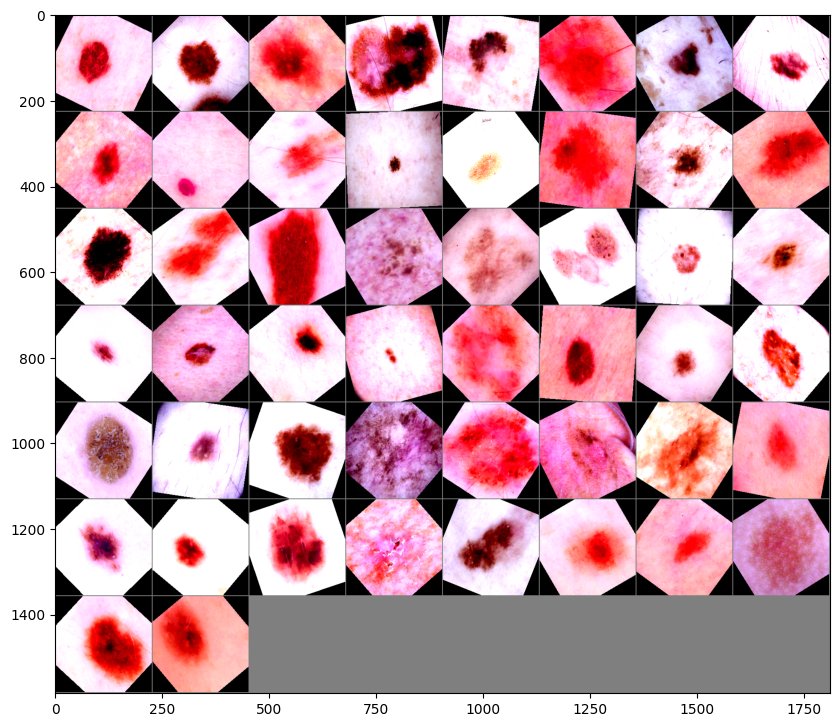

In [17]:
# functions to show an image
fig = plt.figure(figsize=(10, 15))
def imshow(img):
    img = img / 2 + 0.5     # denormalize change this
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))


# get some random training images
dataiter = iter(train_data_loader)
images, labels = next(dataiter)

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join('%5s, ' % classes[labels[j]] for j in range(len(labels))))

# CNN Models

## Lenet

### Defining Lenet

In [ ]:
num_classes = len(classes)
class LeNet(nn.Module):
    def __init__(self):
        super(LeNet, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, (5,5), padding=2)
        self.conv2 = nn.Conv2d(6, 16, (5,5))
        self.fc1   = nn.Linear(16*54*54, 120)
        self.fc2   = nn.Linear(120, 84)
        self.fc3   = nn.Linear(84, num_classes)
    def forward(self, x):
        x = F.max_pool2d(F.relu(self.conv1(x)), (2,2))
        x = F.max_pool2d(F.relu(self.conv2(x)), (2,2))
        x = x.view(-1, self.num_flat_features(x))
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    def num_flat_features(self, x):
        size = x.size()[1:]
        num_features = 1
        for s in size:
            num_features *= s
        return num_features

net = LeNet()
net = net.to(device)

In [ ]:
import torch.optim as optim

class_weights = class_weights.to(device)
criterion = nn.CrossEntropyLoss(weight = class_weights)
optimizer = optim.Adam(net.parameters(), lr=1e-5)
print(net)

In [ ]:
from sklearn.metrics import accuracy_score

def get_accuracy(predicted, labels):
    batch_len, correct= 0, 0
    batch_len = labels.size(0)
    correct = (predicted == labels).sum().item()
    return batch_len, correct

def evaluate(model, val_loader):
    losses= 0
    num_samples_total=0
    correct_total=0
    model.eval()
    for inputs, labels in val_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        out = model(inputs)
        _, predicted = torch.max(out, 1)
        loss = criterion(out, labels)
        losses += loss.item() 
        b_len, corr = get_accuracy(predicted, labels)
        num_samples_total +=b_len
        correct_total +=corr
    accuracy = correct_total/num_samples_total
    losses = losses/len(val_loader)
    return losses, accuracy

### Training Lenet

In [ ]:
# number of loops over the dataset
num_epochs = 50
accuracy = []
val_accuracy = []
losses = []
val_losses = []


for epoch in range(num_epochs):
    running_loss = 0.0
    correct_total= 0.0
    num_samples_total=0.0
    for i, data in enumerate(train_data_loader):
        # get the inputs
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # set the parameter gradients to zero
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        #compute accuracy
        _, predicted = torch.max(outputs, 1)
        b_len, corr = get_accuracy(predicted, labels)
        num_samples_total +=b_len
        correct_total +=corr
        running_loss += loss.item()

    
    running_loss /= len(train_data_loader)
    train_accuracy = correct_total/num_samples_total
    val_loss, val_acc = evaluate(net, validation_data_loader)
    
    print('Epoch: %d' %(epoch+1))
    print('Loss: %.3f  Accuracy:%.3f' %(running_loss, train_accuracy))
    print('Validation Loss: %.3f  Val Accuracy: %.3f' %(val_loss, val_acc))

    losses.append(running_loss)
    val_losses.append(val_loss)
    accuracy.append(train_accuracy)
    val_accuracy.append(val_acc)
print('Finished Training')

In [ ]:
# plt.plot(losses)
# plt.show()

epoch = range(1, num_epochs+1)
fig = plt.figure(figsize=(10, 15))
plt.subplot(2,1,2)
plt.plot(epoch, losses, label='Training loss')
plt.plot(epoch, val_losses, label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.legend()
plt.figure()
plt.show()

fig = plt.figure(figsize=(10, 15))
plt.subplot(2,1,2)
plt.plot(epoch, accuracy, label='Training accuracy')
plt.plot(epoch, val_accuracy, label='Validation accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.legend()
plt.figure()
plt.show()

### Testing Lenet

In [ ]:
fig = plt.figure(figsize=(10, 15))
dataiter = iter(test_data_loader)
images, labels = next(dataiter)

# print images
imshow(torchvision.utils.make_grid(images))
print('GroundTruth: ', ' '.join('%5s,  ' % classes[labels[j]] for j in range(len(labels))))

In [ ]:
correct = 0
total = 0
net.eval()
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print('Accuracy of the network on the test images: %d %%' % (
    100 * correct / total))

In [ ]:
class_correct = list(0. for i in range(len(classes)))
class_total = list(1e-7 for i in range(len(classes)))
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs, 1)
        c = (predicted == labels).squeeze()
        for i in range(3):
            label = labels[i]
            class_correct[label] += c[i].item()
            class_total[label] += 1

for i in range(len(classes)):
    print('Accuracy of %5s : %2d %%' % (
        classes[i], 100 * class_correct[i] / class_total[i]))

In [ ]:
confusion_matrix = torch.zeros(len(classes), len(classes))
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs, 1)
        for t, p in zip(labels.view(-1), predicted.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

cm = confusion_matrix.numpy()

In [ ]:
fig,ax= plt.subplots(figsize=(7,7))
sns.heatmap(cm / (cm.astype(float).sum(axis=1) + 1e-9), annot=False, ax=ax)

# labels, title and ticks
ax.set_xlabel('Predicted', size=25);
ax.set_ylabel('True', size=25); 
ax.set_title('Confusion Matrix', size=25); 
ax.xaxis.set_ticklabels(['akiec','bcc','bkl','df', 'mel', 'nv','vasc'], size=15); \
ax.yaxis.set_ticklabels(['akiec','bcc','bkl','df','mel','nv','vasc'], size=15);

### Grad Cam

In [ ]:
from collections import OrderedDict

class _BaseWrapper(object):
    """
    Please modify forward() and backward() according to your task.
    """

    def __init__(self, model):
        super(_BaseWrapper, self).__init__()
        self.device = next(model.parameters()).device
        self.model = model
        self.handlers = []  # a set of hook function handlers

    def _encode_one_hot(self, ids):
        one_hot = torch.zeros_like(self.logits).to(self.device)
        one_hot.scatter_(1, ids, 1.0)
        return one_hot

    def forward(self, image):
        """
        Simple classification
        """
        self.model.zero_grad()
        self.logits = self.model(image)
        self.probs = F.softmax(self.logits, dim=1)
        return self.probs.sort(dim=1, descending=True)

    def backward(self, ids):
        """
        Class-specific backpropagation
        Either way works:
        1. self.logits.backward(gradient=one_hot, retain_graph=True)
        2. (self.logits * one_hot).sum().backward(retain_graph=True)
        """

        one_hot = self._encode_one_hot(ids)
        self.logits.backward(gradient=one_hot, retain_graph=True)

    def generate(self):
        raise NotImplementedError

    def remove_hook(self):
        """
        Remove all the forward/backward hook functions
        """
        for handle in self.handlers:
            handle.remove()


class GradCAM(_BaseWrapper):
    """
    "Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization"
    https://arxiv.org/pdf/1610.02391.pdf
    Look at Figure 2 on page 4
    """

    def __init__(self, model, candidate_layers=None):
        super(GradCAM, self).__init__(model)
        self.fmap_pool = OrderedDict()
        self.grad_pool = OrderedDict()
        self.candidate_layers = candidate_layers  # list

        def forward_hook(key):
            def forward_hook_(module, input, output):
                # Save featuremaps
                self.fmap_pool[key] = output.detach()

            return forward_hook_

        def backward_hook(key):
            def backward_hook_(module, grad_in, grad_out):
                # Save the gradients correspond to the featuremaps
                self.grad_pool[key] = grad_out[0].detach()

            return backward_hook_

        # If any candidates are not specified, the hook is registered to all the layers.
        for name, module in self.model.named_modules():
            if self.candidate_layers is None or name in self.candidate_layers:
                self.handlers.append(module.register_forward_hook(forward_hook(name)))
                self.handlers.append(module.register_backward_hook(backward_hook(name)))

    def _find(self, pool, target_layer):
        if target_layer in pool.keys():
            return pool[target_layer]
        else:
            raise ValueError("Invalid layer name: {}".format(target_layer))

    def _compute_grad_weights(self, grads):
        return F.adaptive_avg_pool2d(grads, 1)

    def forward(self, image):
        self.image_shape = image.shape[2:]
        return super(GradCAM, self).forward(image)

    def generate(self, target_layer):
        fmaps = self._find(self.fmap_pool, target_layer)
        grads = self._find(self.grad_pool, target_layer)
        weights = self._compute_grad_weights(grads)

        gcam = torch.mul(fmaps, weights).sum(dim=1, keepdim=True)
        gcam = F.relu(gcam)

        gcam = F.interpolate(
            gcam, self.image_shape, mode="bilinear", align_corners=False
        )

        B, C, H, W = gcam.shape
        gcam = gcam.view(B, -1)
        gcam -= gcam.min(dim=1, keepdim=True)[0]
        gcam /= gcam.max(dim=1, keepdim=True)[0]
        gcam = gcam.view(B, C, H, W)

        return gcam

In [ ]:
def demo2(image, label, model):
    """
    Generate Grad-CAM
    """
    # Model
    model = model
    model.to(device)
    model.eval()

    # The layers
    target_layers = ["conv2"]
    target_class = label

    # Images
    images = image.unsqueeze(0)
    gcam = GradCAM(model=model)
    probs, ids = gcam.forward(images)
    ids_ = torch.LongTensor([[target_class]] * len(images)).to(device)
    gcam.backward(ids=ids_)

    for target_layer in target_layers:
        print("Generating Grad-CAM @{}".format(target_layer))

        # Grad-CAM
        regions = gcam.generate(target_layer=target_layer)
        for j in range(len(images)):
            print(
                "\t#{}: {} ({:.5f})".format(
                    j, classes[target_class], float(probs[ids == target_class])
                )
            )
            
            gcam=regions[j, 0]
            plt.imshow(gcam.cpu())
            plt.show()
            
image, label = next(iter(test_data_loader))
# Load the model
model = net
# Grad cam
demo2(image[0].to(device), label[0].to(device), model)


image = np.transpose(image[0], (1,2,0))
image2  = np.add(np.multiply(image.numpy(), np.array(norm_std)) ,np.array(norm_mean))
print("True Class: ", classes[label[0].cpu()])
plt.imshow(image)
plt.show()
plt.imshow(image2)
plt.show()



## Resnet

### Defining Resnet

In [22]:
from torch import nn

num_classes = len(classes)
net = torchvision.models.resnet18(pretrained = True)

# We replace last layer of resnet to match our number of classes which is 7
net.fc = nn.Linear(512, num_classes)
net = net.to(device)

In [23]:
import torch.optim as optim

class_weights = class_weights.to(device)
criterion = nn.CrossEntropyLoss(weight = class_weights)
optimizer = optim.Adam(net.parameters(), lr=1e-5)
print(net)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [24]:
from sklearn.metrics import accuracy_score

def get_accuracy(predicted, labels):
    batch_len, correct= 0, 0
    batch_len = labels.size(0)
    correct = (predicted == labels).sum().item()
    return batch_len, correct

def evaluate(model, val_loader):
    losses= 0
    num_samples_total=0
    correct_total=0
    model.eval()
    for inputs, labels in val_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        out = model(inputs)
        _, predicted = torch.max(out, 1)
        loss = criterion(out, labels)
        losses += loss.item() 
        b_len, corr = get_accuracy(predicted, labels)
        num_samples_total +=b_len
        correct_total +=corr
    accuracy = correct_total/num_samples_total
    losses = losses/len(val_loader)
    return losses, accuracy

### Training Resnet

In [25]:
# number of loops over the dataset
num_epochs = 70
accuracy = []
val_accuracy = []
losses = []
val_losses = []


for epoch in range(num_epochs):
    running_loss = 0.0
    correct_total= 0.0
    num_samples_total=0.0
    for i, data in enumerate(train_data_loader):
        # get the inputs
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # set the parameter gradients to zero
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        
        #compute accuracy
        _, predicted = torch.max(outputs, 1)
        b_len, corr = get_accuracy(predicted, labels)
        num_samples_total +=b_len
        correct_total +=corr
        running_loss += loss.item()

    
    running_loss /= len(train_data_loader)
    train_accuracy = correct_total/num_samples_total
    val_loss, val_acc = evaluate(net, validation_data_loader)
    
    print('Epoch: %d' %(epoch+1))
    print('Loss: %.3f  Accuracy:%.3f' %(running_loss, train_accuracy))
    print('Validation Loss: %.3f  Val Accuracy: %.3f' %(val_loss, val_acc))

    losses.append(running_loss)
    val_losses.append(val_loss)
    accuracy.append(train_accuracy)
    val_accuracy.append(val_acc)
print('Finished Training')

Epoch: 1
Loss: 1.614  Accuracy:0.302
Validation Loss: 1.184  Val Accuracy: 0.597
Epoch: 2
Loss: 0.788  Accuracy:0.684
Validation Loss: 0.714  Val Accuracy: 0.716
Epoch: 3
Loss: 0.675  Accuracy:0.709
Validation Loss: 0.636  Val Accuracy: 0.714
Epoch: 4
Loss: 0.598  Accuracy:0.730
Validation Loss: 0.630  Val Accuracy: 0.703
Epoch: 5
Loss: 0.562  Accuracy:0.738
Validation Loss: 0.585  Val Accuracy: 0.735
Epoch: 6
Loss: 0.530  Accuracy:0.751
Validation Loss: 0.590  Val Accuracy: 0.720
Epoch: 7
Loss: 0.515  Accuracy:0.756
Validation Loss: 0.600  Val Accuracy: 0.715
Epoch: 8
Loss: 0.472  Accuracy:0.765
Validation Loss: 0.562  Val Accuracy: 0.767
Epoch: 9
Loss: 0.452  Accuracy:0.778
Validation Loss: 0.604  Val Accuracy: 0.777
Epoch: 10
Loss: 0.432  Accuracy:0.785
Validation Loss: 0.545  Val Accuracy: 0.751
Epoch: 11
Loss: 0.410  Accuracy:0.788
Validation Loss: 0.521  Val Accuracy: 0.763
Epoch: 12
Loss: 0.401  Accuracy:0.795
Validation Loss: 0.518  Val Accuracy: 0.789
Epoch: 13
Loss: 0.366  Ac

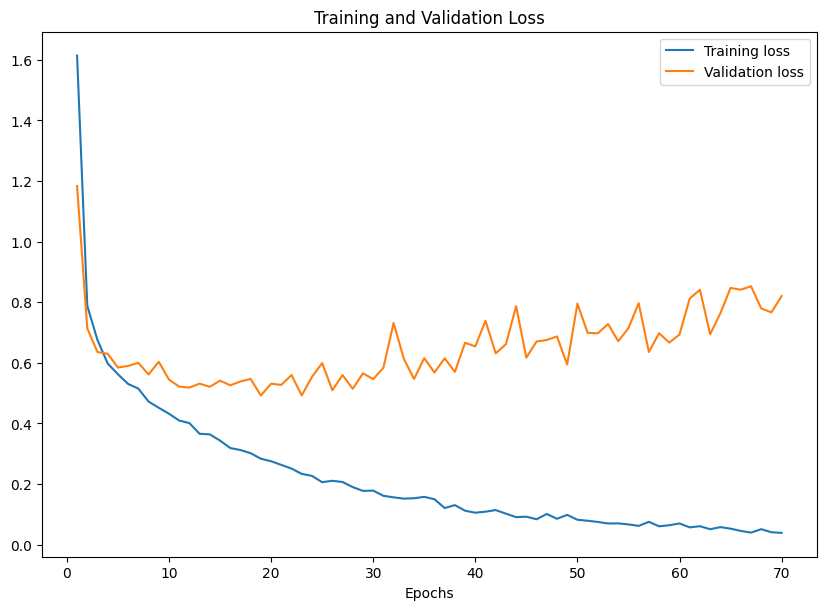

<Figure size 640x480 with 0 Axes>

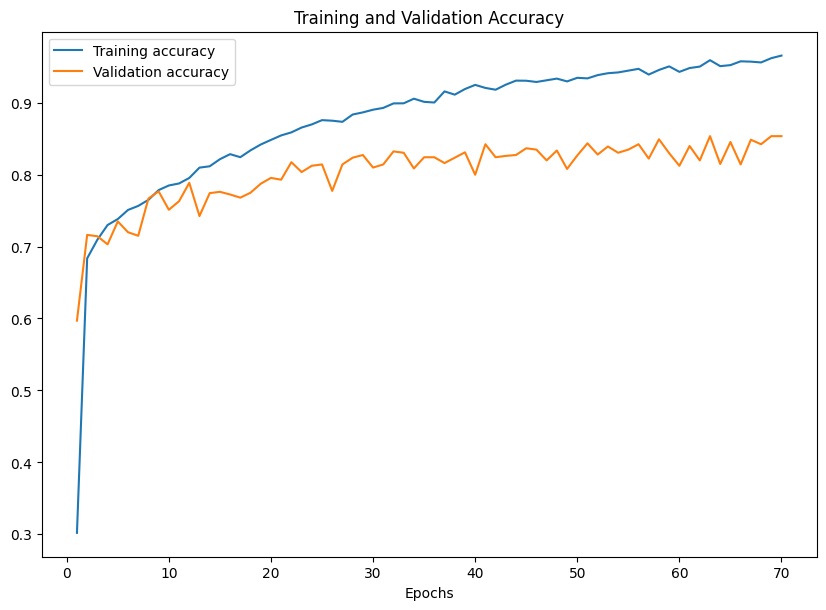

<Figure size 640x480 with 0 Axes>

In [26]:
# plt.plot(losses)
# plt.show()

epoch = range(1, num_epochs+1)
fig = plt.figure(figsize=(10, 15))
plt.subplot(2,1,2)
plt.plot(epoch, losses, label='Training loss')
plt.plot(epoch, val_losses, label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.legend()
plt.figure()
plt.show()

fig = plt.figure(figsize=(10, 15))
plt.subplot(2,1,2)
plt.plot(epoch, accuracy, label='Training accuracy')
plt.plot(epoch, val_accuracy, label='Validation accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.legend()
plt.figure()
plt.show()

### Testing Resnet

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   melanoma,   dermatofibroma,   basal cell carcinoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   actinic keratoses,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   basal cell carcinoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   actinic keratoses,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   actinic keratoses,   basal cell carcinoma,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanoma,   melanoma,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   vascular lesions,  
GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanoma,   melanoma,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   vascular lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  vascular lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   vascular lesions,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  basal cell carcinoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   vascular lesions,   basal cell carcinoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   vascular lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,  
GroundTruth:  actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   actinic keratoses,   melanoma,  
GroundTruth:  actinic keratoses,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanocytic nevi,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   vascular lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   actinic keratoses,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanoma,   melanocytic nevi,  
GroundTruth:  dermatofibroma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanoma,   actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   vascular lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   dermatofibroma,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   basal cell carcinoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   actinic keratoses,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   basal cell carcinoma,  
GroundTruth:  basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   dermatofibroma,   basal cell carcinoma,   actinic keratoses,   melanocytic nevi,   actinic keratoses,   vascular lesions,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanoma,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  
GroundTruth:  melanocytic nevi,   vascular lesions,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanoma,   benign keratosis-like lesions,   melanoma,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   vascular lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   actinic keratoses,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   actinic keratoses,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   vascular lesions,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,  
GroundTruth:  benign keratosis-like lesions,   benign keratosis-like lesions,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   benign keratosis-like lesions,   actinic keratoses,   benign keratosis-like lesions,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  
GroundTruth:  vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanoma,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanoma,   benign keratosis-like lesions,   melanoma,  
GroundTruth:  melanocytic nevi,   vascular lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   dermatofibroma,   vascular lesions,   basal cell carcinoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanoma,   melanoma,  
GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   vascular lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   vascular lesions,   melanocytic nevi,  
GroundTruth:  melanoma,   dermatofibroma,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   basal cell carcinoma,  
GroundTruth:  melanoma,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   actinic keratoses,   melanocytic nevi,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   actinic keratoses,   dermatofibroma,   benign keratosis-like lesions,   benign keratosis-like lesions,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   basal cell carcinoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   benign keratosis-like lesions,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  basal cell carcinoma,   melanocytic nevi,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,  
GroundTruth:  melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   basal cell carcinoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  benign keratosis-like lesions,   basal cell carcinoma,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  
GroundTruth:  benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   vascular lesions,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  actinic keratoses,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   vascular lesions,   melanoma,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanoma,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   vascular lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanoma,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   vascular lesions,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   actinic keratoses,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanoma,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   dermatofibroma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanoma,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanoma,   benign keratosis-like lesions,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanoma,   benign keratosis-like lesions,   melanocytic nevi,   benign keratosis-like lesions,   melanoma,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   basal cell carcinoma,   basal cell carcinoma,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   benign keratosis-like lesions,   melanoma,  
GroundTruth:  basal cell carcinoma,   basal cell carcinoma,   melanoma,   melanocytic nevi,   melanoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   basal cell carcinoma,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   melanocytic nevi,   benign keratosis-like lesions,   melanocytic nevi,   melanocytic nevi,   actinic keratoses,   melanocytic nevi,   melanocytic nevi,   melanocytic nevi,  
GroundTruth:  melanocytic nevi,   melanocytic nevi,   actinic keratoses,  


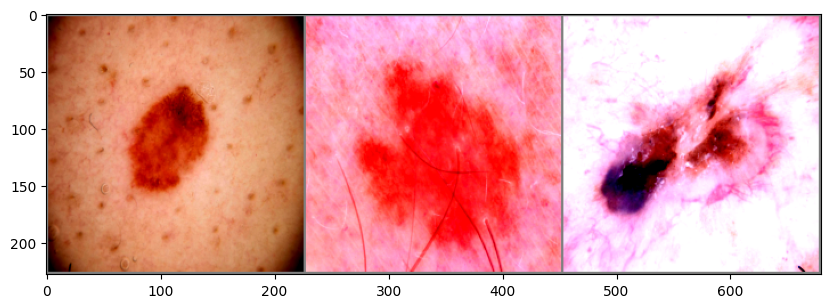

In [29]:
fig = plt.figure(figsize=(10, 15))
# dataiter = iter(test_data_loader)
# images, labels = dataiter.next()
for images, labels in test_data_loader:
    # print images
    imshow(torchvision.utils.make_grid(images))
    print('GroundTruth: ', ' '.join('%5s,  ' % classes[labels[j]] for j in range(len(labels))))

In [30]:
correct = 0
total = 0
net.eval()
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print('Accuracy of the network on the test images: %d %%' % (
    100 * correct / total))

Accuracy of the network on the test images: 82 %


In [31]:
class_correct = list(0. for i in range(len(classes)))
class_total = list(1e-7 for i in range(len(classes)))
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs, 1)
        c = (predicted == labels).squeeze()
        for i in range(3):
            label = labels[i]
            class_correct[label] += c[i].item()
            class_total[label] += 1

for i in range(len(classes)):
    print('Accuracy of %5s : %2d %%' % (
        classes[i], 100 * class_correct[i] / class_total[i]))

Accuracy of actinic keratoses : 16 %
Accuracy of basal cell carcinoma : 66 %
Accuracy of benign keratosis-like lesions : 70 %
Accuracy of dermatofibroma : 49 %
Accuracy of melanoma : 56 %
Accuracy of melanocytic nevi : 93 %
Accuracy of vascular lesions : 71 %


In [32]:
class_correct = list(0. for i in range(len(classes)))
class_total = list(1e-7 for i in range(len(classes)))
net.eval()
with torch.no_grad():
    for data in validation_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs, 1)
        c = (predicted == labels).squeeze()
        for i in range(3):
            label = labels[i]
            class_correct[label] += c[i].item()
            class_total[label] += 1

for i in range(len(classes)):
    print('Accuracy of %5s : %2d %%' % (
        classes[i], 100 * class_correct[i] / class_total[i]))

Accuracy of actinic keratoses : 33 %
Accuracy of basal cell carcinoma : 62 %
Accuracy of benign keratosis-like lesions : 67 %
Accuracy of dermatofibroma : 79 %
Accuracy of melanoma : 71 %
Accuracy of melanocytic nevi : 93 %
Accuracy of vascular lesions : 79 %


In [38]:
confusion_matrix = torch.zeros(len(classes), len(classes))
with torch.no_grad():
    for data in test_data_loader:
        images, labels = data
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        _, predicted = torch.max(outputs, 1)
        for t, p in zip(labels.view(-1), predicted.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

print(confusion_matrix)
cm = confusion_matrix.numpy()

tensor([[1.5000e+01, 5.0000e+00, 1.1000e+01, 1.0000e+00, 2.2000e+01, 1.1000e+01,
         0.0000e+00],
        [4.0000e+00, 6.4000e+01, 1.1000e+01, 2.0000e+00, 8.0000e+00, 1.1000e+01,
         3.0000e+00],
        [5.0000e+00, 2.0000e+00, 1.5400e+02, 2.0000e+00, 2.5000e+01, 3.2000e+01,
         0.0000e+00],
        [1.0000e+00, 3.0000e+00, 2.0000e+00, 9.0000e+00, 1.0000e+00, 7.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.4000e+01, 0.0000e+00, 1.4300e+02, 6.6000e+01,
         0.0000e+00],
        [0.0000e+00, 6.0000e+00, 2.7000e+01, 2.0000e+00, 5.3000e+01, 1.2510e+03,
         2.0000e+00],
        [0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.0000e+00,
         2.1000e+01]])


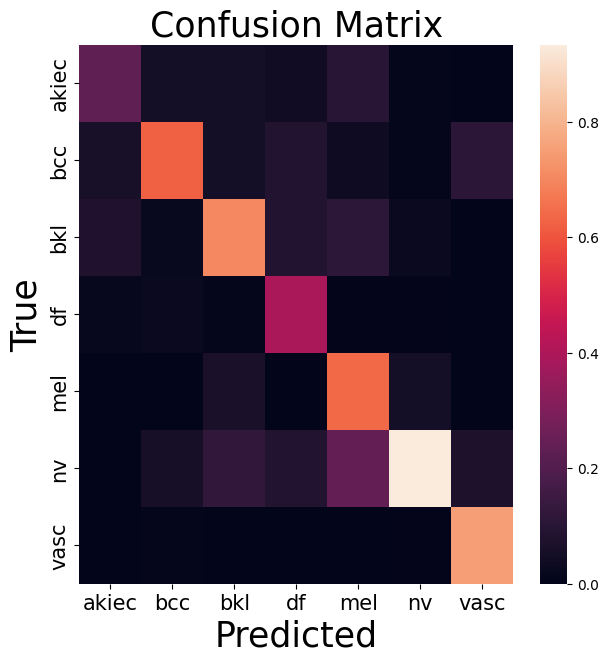

In [39]:
fig,ax= plt.subplots(figsize=(7,7))
sns.heatmap(cm / (cm.astype(float).sum(axis=1) + 1e-9), annot=False, ax=ax)

# labels, title and ticks
ax.set_xlabel('Predicted', size=25);
ax.set_ylabel('True', size=25); 
ax.set_title('Confusion Matrix', size=25); 
ax.xaxis.set_ticklabels(['akiec','bcc','bkl','df', 'mel', 'nv','vasc'], size=15); \
ax.yaxis.set_ticklabels(['akiec','bcc','bkl','df','mel','nv','vasc'], size=15);



### Gradcam

In [42]:
from collections import OrderedDict
from collections.abc import Sequence

class _BaseWrapper(object):
    """
    Please modify forward() and backward() according to your task.
    """

    def __init__(self, model):
        super(_BaseWrapper, self).__init__()
        self.device = next(model.parameters()).device
        self.model = model
        self.handlers = []  # a set of hook function handlers

    def _encode_one_hot(self, ids):
        one_hot = torch.zeros_like(self.logits).to(self.device)
        one_hot.scatter_(1, ids, 1.0)
        return one_hot

    def forward(self, image):
        """
        Simple classification
        """
        self.model.zero_grad()
        self.logits = self.model(image)
        self.probs = F.softmax(self.logits, dim=1)
        return self.probs.sort(dim=1, descending=True)

    def backward(self, ids):
        """
        Class-specific backpropagation
        Either way works:
        1. self.logits.backward(gradient=one_hot, retain_graph=True)
        2. (self.logits * one_hot).sum().backward(retain_graph=True)
        """

        one_hot = self._encode_one_hot(ids)
        self.logits.backward(gradient=one_hot, retain_graph=True)

    def generate(self):
        raise NotImplementedError

    def remove_hook(self):
        """
        Remove all the forward/backward hook functions
        """
        for handle in self.handlers:
            handle.remove()


class GradCAM(_BaseWrapper):
    """
    "Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization"
    https://arxiv.org/pdf/1610.02391.pdf
    Look at Figure 2 on page 4
    """

    def __init__(self, model, candidate_layers=None):
        super(GradCAM, self).__init__(model)
        self.fmap_pool = OrderedDict()
        self.grad_pool = OrderedDict()
        self.candidate_layers = candidate_layers  # list

        def forward_hook(key):
            def forward_hook_(module, input, output):
                # Save featuremaps
                self.fmap_pool[key] = output.detach()

            return forward_hook_

        def backward_hook(key):
            def backward_hook_(module, grad_in, grad_out):
                # Save the gradients correspond to the featuremaps
                self.grad_pool[key] = grad_out[0].detach()

            return backward_hook_

        # If any candidates are not specified, the hook is registered to all the layers.
        for name, module in self.model.named_modules():
            if self.candidate_layers is None or name in self.candidate_layers:
                self.handlers.append(module.register_forward_hook(forward_hook(name)))
                self.handlers.append(module.register_backward_hook(backward_hook(name)))

    def _find(self, pool, target_layer):
        if target_layer in pool.keys():
            return pool[target_layer]
        else:
            raise ValueError("Invalid layer name: {}".format(target_layer))

    def _compute_grad_weights(self, grads):
        return F.adaptive_avg_pool2d(grads, 1)

    def forward(self, image):
        self.image_shape = image.shape[2:]
        return super(GradCAM, self).forward(image)

    def generate(self, target_layer):
        fmaps = self._find(self.fmap_pool, target_layer)
        grads = self._find(self.grad_pool, target_layer)
        weights = self._compute_grad_weights(grads)

        gcam = torch.mul(fmaps, weights).sum(dim=1, keepdim=True)
        gcam = F.relu(gcam)

        gcam = F.interpolate(
            gcam, self.image_shape, mode="bilinear", align_corners=False
        )

        B, C, H, W = gcam.shape
        gcam = gcam.view(B, -1)
        gcam -= gcam.min(dim=1, keepdim=True)[0]
        gcam /= gcam.max(dim=1, keepdim=True)[0]
        gcam = gcam.view(B, C, H, W)

        return gcam

/usr/cs/grad/masters/2025/dpawar/chm/env/lib/python3.10/site-packages/torch/nn/modules/module.py:1352: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


Generating Grad-CAM @layer4
	#0: melanocytic nevi (1.00000)


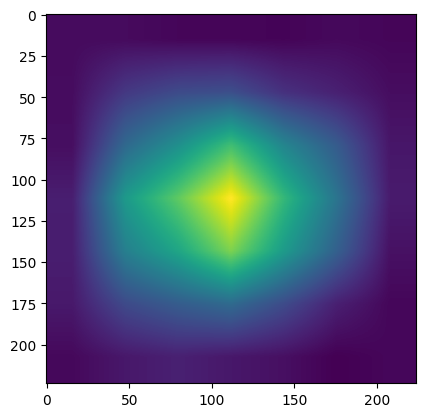

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Class:  melanocytic nevi


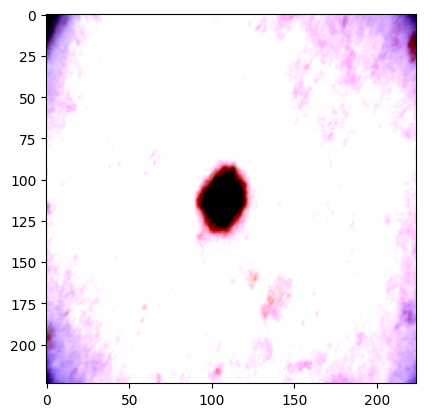

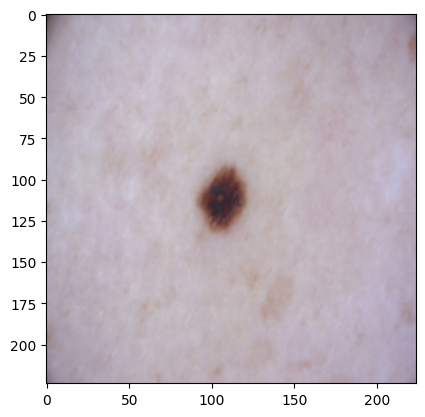

In [43]:
def demo2(image, label, model):
    """
    Generate Grad-CAM
    """
    # Model
    model = model
    model.to(device)
    model.eval()

    # The layers
    target_layers = ["layer4"]
    target_class = label

    # Images
    images = image.unsqueeze(0)
    gcam = GradCAM(model=model)
    probs, ids = gcam.forward(images)
    ids_ = torch.LongTensor([[target_class]] * len(images)).to(device)
    gcam.backward(ids=ids_)

    for target_layer in target_layers:
        print("Generating Grad-CAM @{}".format(target_layer))

        # Grad-CAM
        regions = gcam.generate(target_layer=target_layer)
        for j in range(len(images)):
            print(
                "\t#{}: {} ({:.5f})".format(
                    j, classes[target_class], float(probs[ids == target_class])
                )
            )
            
            gcam=regions[j, 0]
            plt.imshow(gcam.cpu())
            plt.show()
            
image, label = next(iter(test_data_loader))
# Load the model
model = net
# Grad cam
demo2(image[0].to(device), label[0].to(device), model)


image = np.transpose(image[0], (1,2,0))
image2  = np.add(np.multiply(image.numpy(), np.array(norm_std)) ,np.array(norm_mean))
print("True Class: ", classes[label[0].cpu()])
plt.imshow(image)
plt.show()
plt.imshow(image2)
plt.show()



In [ ]:
torch.save(model.state_dict(), '/usr/cs/grad/masters/2025/dpawar/chm/resnet.pt')

# End